WAV file loaded from local path: C:\Users\egor_\Desktop\tests\audiospylt\gmth\bayle.wav
Number of audio channels: 1
Sampling rate: 44100 Hz
WAV file loaded from gmth/bayle.wav
Total duration: 7.689 seconds


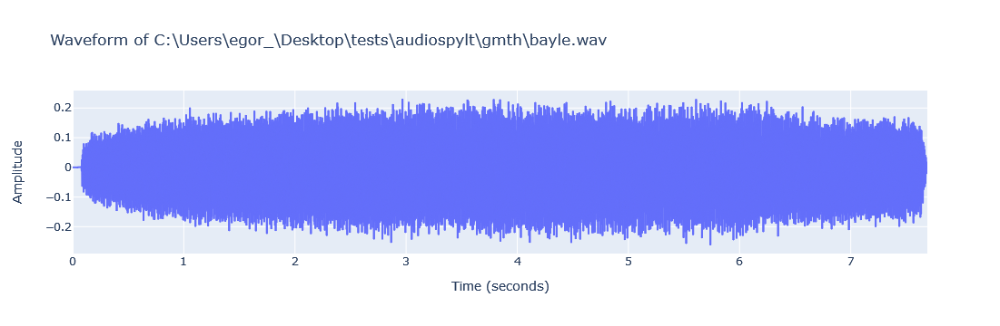

In [1]:
from IPython.display import Audio, display
from audio_utils import load_wav_from_source, load_audio_data, display_audio_properties, plot_waveform

# Adjustable variables
wav_source = 'gmth/bayle.wav'
desired_sample_rate = None
convert_to_mono = True

# Load WAV and audio data
wav_filename = load_wav_from_source(wav_source)
audio_data, sample_rate = load_audio_data(wav_filename, desired_sample_rate, convert_to_mono)

# Display audio properties
num_channels = display_audio_properties(audio_data, sample_rate, wav_source)
# Plot waveform and get duration
duration = plot_waveform(audio_data, sample_rate, wav_filename)

# If the audio data is multi-channel, select the first channel to display
if num_channels > 1:
    audio_data = audio_data[:, 0]

# Create an audio player for the loaded file
display(Audio(audio_data, rate=sample_rate))

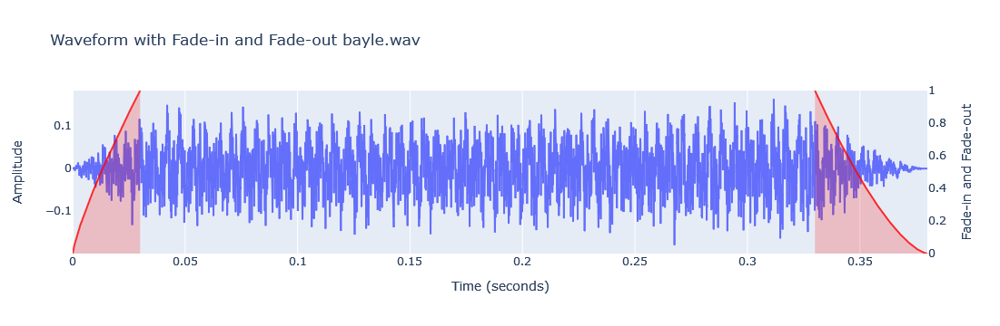

In [2]:
from audio_utils import trim_and_fade_audio

start_time = 0.37
end_time = 0.75
add_fades = True
fade_in_duration = 0.03
fade_out_duration = 0.05
fade_in_exponent = 0.8
fade_out_exponent = 1.5

cut_audio_data, cut_duration = trim_and_fade_audio(audio_data, sample_rate, num_channels, duration, wav_filename, start_time, 
                                                   end_time, add_fades, fade_in_duration, fade_out_duration, 
                                                   fade_in_exponent, fade_out_exponent)

# Create an audio player for the loaded file
display(Audio(cut_audio_data, rate=sample_rate))

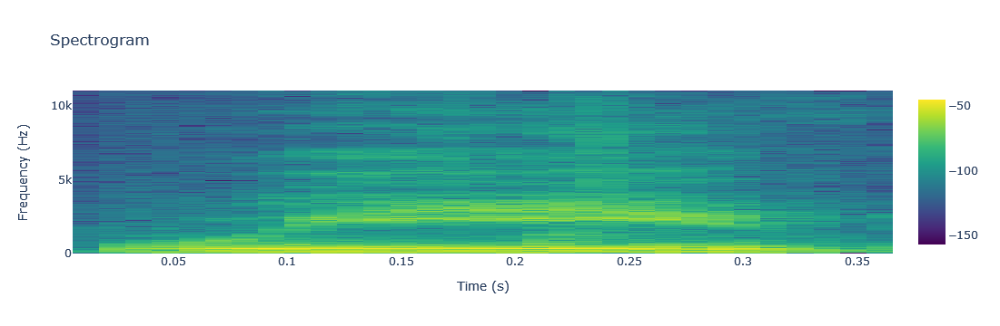

In [5]:
import numpy as np
import plotly.graph_objects as go
from scipy.signal import spectrogram

# Compute the spectrogram data
frequencies, times, Sxx = spectrogram(cut_audio_data, fs=sample_rate, nperseg=512, noverlap=256)

# Convert the amplitude spectrogram to dB scale
Sxx_dB = 10 * np.log10(Sxx)

# Display the spectrogram using Plotly
fig = go.Figure(data=go.Heatmap(z=Sxx_dB, x=times, y=frequencies, colorscale='Viridis', zmin=np.min(Sxx_dB), zmax=np.max(Sxx_dB)))
fig.update_layout(title="Spectrogram",
                  xaxis_title="Time (s)",
                  yaxis_title="Frequency (Hz)")

fig.show()


Save trimmed file if needed:

In [3]:
from generate_wave_file import generate_wave_file

y_combined_no_nan = np.nan_to_num(cut_audio_data)

generate_wave_file(y_combined_no_nan, sample_rate, fs_target_name='44.1kHz', bit_rate=24)

# add custom_filename='my_custom_filename.wav' if needed


[2023-08-26 18:35:25] 24-bit wave file with 44.1kHz sampling rate saved successfully to: C:\Users\egor_\Desktop\tests\audiospylt\generated_wave_file_44.1kHz_24bit_18_35_25.wav


File name: preamble10.wav
Duration (s): 0.38
Sampling rate (Hz): 22050

Maximum amplitude value: 0.007562
Total number of bands: 4190
Frequency resolution (Hz): 2.631579

Amplitude Threshold 1: 0.0005
Amplitude Threshold 2: 0.011
Frequency Threshold 1 (Hz): 30
Frequency Threshold 2 (Hz): 4500

Peaks:


,Frequency (Hz),Amplitude
0,97.368421,0.000965
1,105.263158,0.005521
2,110.526316,0.002423
3,194.736842,0.001351
4,202.631579,0.003517
5,210.526316,0.007408
6,215.789474,0.005467
7,223.684211,0.004954
8,228.947368,0.003144
9,292.105263,0.001261


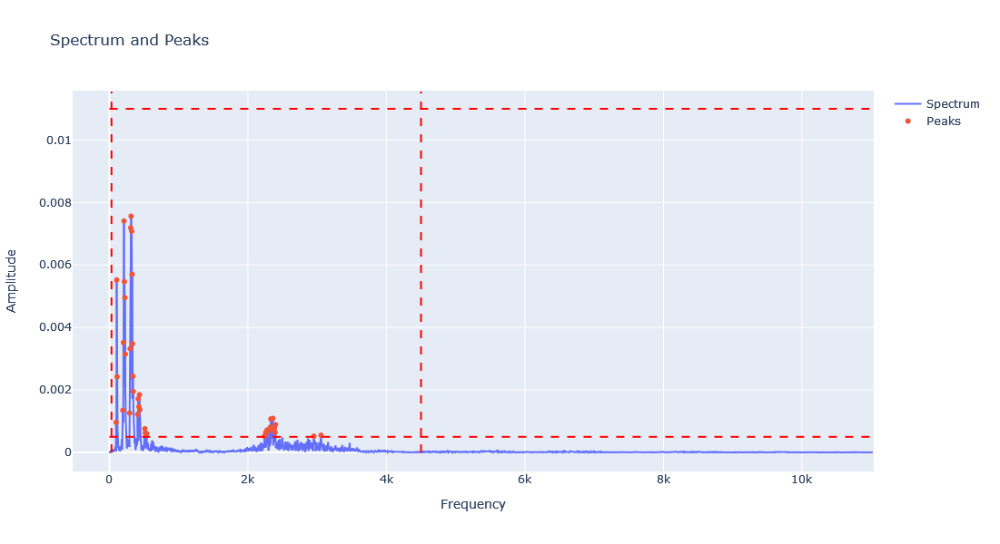

In [7]:
from dft_analysis import analyze_signal


peaks_df = analyze_signal(
        signal=cut_audio_data, 
        sr=sample_rate, 
        filename=wav_source,
        window_type='boxcar', 
        thresh_amp_low=0.0005, 
        thresh_amp_high=0.011, 
        thresh_freq_low=30, 
        thresh_freq_high=4500, 
        prominence=0.00005, 
        width=None,
        show_peaks=True, 
        show_plot=True
    )


In [8]:
import os
from datetime import datetime

# save the DataFrame as a TSV file
filename = 'speech1.tsv'
try:
    peaks_df.to_csv(filename, sep='\t', index=False)
    print(f"Data saved successfully to {os.getcwd()}\\{filename} at {datetime.now()}.")
except:
    print("Error: data could not be saved.")

Data saved successfully to C:\Users\egor_\Desktop\tests\audiospylt\speech1.tsv at 2023-09-18 19:55:56.074836.
